In [1]:

import warnings
import scanpy as sc
import seaborn as sns
import numpy as np
import h5py
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import matplotlib as plt

# Core scientific libs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import logging
from scipy.stats import median_abs_deviation
import scipy.sparse as sp



# Plotting settings
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 0
sns.set(rc={"figure.figsize": (4, 3.5), "figure.dpi": 100})
sns.set_style("whitegrid")

sc.settings.set_figure_params(
    dpi=300,        # inline resolution
    dpi_save=300,   # saved figures
    frameon=False
)


import os
wdir = "/mnt/nfs/CX000008_DS1/projects/gaurav/mistr/published_dataset_analyis/yuan_et_al/"
os.chdir( wdir )

## read day 9 MiSTR (10X genomics)
## read. yuan eat al 

In [ ]:
d9d = sc.read_h5ad('/mnt/nfs/CX000008_DS1/projects/gaurav/mistr/h5ad_files/raw/d9d/d9d.velocity.raw.h5ad')
yuan = sc.read_h5ad('yuan_cs9.h5ad')

d9d.obs['annotations'] = d9d.obs['seurat_clusters'].astype('category')

new_cluster_names_d9d = ['d9_Hindbrain 0',
'd9_FB, Presumptive Diencephalon 1',
'd9_Caudal MHB 2',
'd9_Rostral MHB 3',
'd9_Hindbrain 4',
'd9_FB, Presumptive Telencephalon 5',
'd9_undefined 6',
'd9_Forebrain 7',
'd9_MHB (Hindbrain side) 8',
'd9_Neuronal precursors, MB/FB 9',
'd9_Neural Crest 10']

d9d.rename_categories('annotations', new_cluster_names_d9d)

# Remove undefined cluster from d9d
bad_cluster = "d9_undefined 6"

print("Before filtering:")
print(d9d.obs["annotations"].value_counts())

d9d = d9d[d9d.obs["annotations"] != bad_cluster].copy()

# drop the unused category so it doesn't silently persist
d9d.obs["annotations"] = d9d.obs["annotations"].cat.remove_unused_categories()

print("\nAfter filtering:")
print(d9d.obs["annotations"].value_counts())


print("scanpy:", sc.__version__)
#print("scvi-tools:", scvi.__version__)

print("\n--- yuan ---")
print(yuan)
print("obs cols (first 12):", list(yuan.obs.columns)[:12])
print("layers:", list(yuan.layers.keys())[:10])

print("\n--- d9d ---")
print(d9d)
print("obs cols (first 12):", list(d9d.obs.columns)[:12])
print("layers:", list(d9d.layers.keys())[:10])



Before filtering:
annotations
d9_Hindbrain 0                        2994
d9_FB, Presumptive Diencephalon 1     2980
d9_Caudal MHB 2                       2162
d9_Rostral MHB 3                      1543
d9_Hindbrain 4                        1348
d9_FB, Presumptive Telencephalon 5     966
d9_undefined 6                         633
d9_Forebrain 7                         278
d9_MHB (Hindbrain side) 8              258
d9_Neuronal precursors, MB/FB 9        218
d9_Neural Crest 10                      69
Name: count, dtype: int64

After filtering:
annotations
d9_Hindbrain 0                        2994
d9_FB, Presumptive Diencephalon 1     2980
d9_Caudal MHB 2                       2162
d9_Rostral MHB 3                      1543
d9_Hindbrain 4                        1348
d9_FB, Presumptive Telencephalon 5     966
d9_Forebrain 7                         278
d9_MHB (Hindbrain side) 8              258
d9_Neuronal precursors, MB/FB 9        218
d9_Neural Crest 10                      69
Name: count

In [22]:
import numpy as np

def quick_stats(adata, name):
    print(f"\n=== {name} ===")
    print("uns['X_name']:", adata.uns.get("X_name", None))
    X = adata.X
    # handle sparse
    if hasattr(X, "A1"):
        xmin, xmax = X.min(), X.max()
    else:
        xmin, xmax = X.min(), X.max()
    print("X min/max:", float(xmin), float(xmax), "dtype:", X.dtype)

    for k in list(adata.layers.keys()):
        L = adata.layers[k]
        lmin, lmax = L.min(), L.max()
        print(f"layer[{k}] min/max:", float(lmin), float(lmax), "dtype:", L.dtype)

    # check "integer-likeness" of X (raw counts should be mostly integers)
    # sample up to 50k values
    rng = np.random.default_rng(0)
    if hasattr(X, "tocoo"):
        coo = X.tocoo()
        vals = coo.data
    else:
        vals = np.asarray(X).ravel()
    if vals.size == 0:
        print("X has no values?")
        return
    take = min(vals.size, 50000)
    sample = vals[rng.choice(vals.size, size=take, replace=False)]
    frac_intlike = np.mean(np.isclose(sample, np.round(sample)))
    print("fraction ~integer (sample):", float(frac_intlike))

quick_stats(yuan, "yuan")
quick_stats(d9d, "d9d")


=== yuan ===
uns['X_name']: counts
X min/max: 0.0 2151.0 dtype: float64
layer[logcounts] min/max: 0.0 2151.0 dtype: float64
fraction ~integer (sample): 1.0

=== d9d ===
uns['X_name']: None
X min/max: 0.0 2377.0 dtype: float32
layer[ambiguous] min/max: 0.0 1787.0 dtype: float64
layer[spliced] min/max: 0.0 1416.0 dtype: float64
layer[unspliced] min/max: 0.0 396.0 dtype: float64
fraction ~integer (sample): 1.0


In [ ]:
# =========================
# — Build ref/qry (d9d/yuan) + filter query to FBP/MBP/HBP
#          + SAFE carry: celltype + qry_celltype (query) with NA placeholders in ref
#          + harmonize genes (SAFE) + concat
#          + HVGs(3k) + Train scVI + Train scANVI (joint)
# =========================
import scanpy as sc
import numpy as np
import pandas as pd
import scvi

# ---------- 0) Fresh copies ----------
ref = d9d.copy()
qry = yuan.copy()

# ---------- 1) Filter query to FBP/MBP/HBP ----------
if "celltype" not in qry.obs.columns:
    raise ValueError("Query must have obs['celltype'].")

mhb_keep = {"FBP", "MBP", "HBP"}
qry = qry[qry.obs["celltype"].isin(mhb_keep)].copy()

print(f"Filtered query to FBP/MBP/HBP: {qry.n_obs} cells")
print("Query cell types:\n", qry.obs["celltype"].value_counts())

# ---------- 1b) Preserve query original label ----------
qry.obs["qry_celltype"] = pd.Categorical(qry.obs["celltype"].astype(str))

# ---------- 1c) FORCE these columns to exist in REF (placeholders) ----------
# This guarantees scanpy.concat will keep them.
ref.obs["celltype"] = pd.Categorical([np.nan] * ref.n_obs)
ref.obs["qry_celltype"] = pd.Categorical([np.nan] * ref.n_obs)

# ---------- 2) Ensure counts layer exists ----------
if "counts" not in ref.layers:
    ref.layers["counts"] = ref.X.copy()

if "spliced" in qry.layers:
    qry.layers["counts"] = qry.layers["spliced"].copy()
elif "counts" in qry.layers:
    qry.layers["counts"] = qry.layers["counts"].copy()
else:
    qry.layers["counts"] = qry.X.copy()

# quick sanity (catch negatives)
def _layer_minmax(a, layer="counts"):
    X = a.layers[layer]
    mn = float(X.min())
    mx = float(X.max())
    return mn, mx, str(X.dtype)

mn_ref, mx_ref, dt_ref = _layer_minmax(ref, "counts")
mn_qry, mx_qry, dt_qry = _layer_minmax(qry, "counts")
print(f"\ncounts sanity | ref: min={mn_ref:.3g} max={mx_ref:.3g} dtype={dt_ref}")
print(f"counts sanity | qry: min={mn_qry:.3g} max={mx_qry:.3g} dtype={dt_qry}")
if mn_ref < 0 or mn_qry < 0:
    raise ValueError("Negative values found in counts layer. scVI/scANVI expects non-negative counts-like data.")

# ---------- 3) Reference labels ----------
ref_label_key = (
    "annotations" if "annotations" in ref.obs.columns else
    ("celltype" if "celltype" in ref.obs.columns else "ident")
)
if ref_label_key not in ref.obs.columns:
    raise ValueError("Reference must contain obs['annotations'] or obs['celltype'] or obs['ident'].")

ref.obs["ref_celltype"] = pd.Categorical(ref.obs[ref_label_key].astype(str))
print("\nReference label key used:", ref_label_key)
print("Reference label distribution (top 30):\n", ref.obs["ref_celltype"].value_counts().head(30))

# ---------- 4) Gene harmonization (SAFE) + intersect ----------
ref.var_names = ref.var_names.astype(str).str.upper()
qry.var_names = qry.var_names.astype(str).str.upper()
ref.var_names_make_unique()
qry.var_names_make_unique()

common = ref.var_names.intersection(qry.var_names)
print("\nCommon genes:", len(common))
ref = ref[:, common].copy()
qry = qry[:, common].copy()

# ---------- 5) metadata + labels for scANVI training ----------
ref.obs["dataset"] = "mistr_d9"
qry.obs["dataset"] = "yuan_cs9"

ref.obs["label_for_scanvi"] = ref.obs["ref_celltype"].astype(str).values
qry.obs["label_for_scanvi"] = "unknown"

# ensure consistent categories across ref/qry for label_for_scanvi
cats = list(ref.obs["ref_celltype"].cat.categories)
if "unknown" not in cats:
    cats = cats + ["unknown"]
ref.obs["label_for_scanvi"] = pd.Categorical(ref.obs["label_for_scanvi"], categories=cats)
qry.obs["label_for_scanvi"] = pd.Categorical(qry.obs["label_for_scanvi"], categories=cats)

# ---------- 6) concat (no rebuild logic needed now) ----------
adata = sc.concat(
    {"ref": ref, "qry": qry},
    label="source",
    join="inner",
    merge="first",
    index_unique="-"
)

# ---------- 6b) sanity: qry_celltype should exist + be filled for query ----------
qry_mask = adata.obs["source"] == "qry"
print("\nSanity after concat:")
print("Total cells:", adata.n_obs)
print("source counts:\n", adata.obs["source"].value_counts())
print("qry_celltype counts (query only):\n", adata.obs.loc[qry_mask, "qry_celltype"].value_counts(dropna=False))

# ---------- 7) HVGs (3k) ----------
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=3000,
    layer="counts",
    batch_key="dataset",
)
print("HVGs:", int(adata.var["highly_variable"].sum()))

adata_hvg = adata[:, adata.var["highly_variable"]].copy()

# ---------- 8) Train scVI ----------
scvi.model.SCVI.setup_anndata(
    adata_hvg,
    layer="counts",
    batch_key="dataset"
)

vae = scvi.model.SCVI(adata_hvg, n_latent=30)
vae.train(max_epochs=60, early_stopping=True)

adata_hvg.obsm["X_scVI"] = vae.get_latent_representation()
sc.pp.neighbors(adata_hvg, use_rep="X_scVI", n_neighbors=30)
sc.tl.umap(adata_hvg, random_state=0)

# ---------- 9) Train scANVI (joint) ----------
scanvi = scvi.model.SCANVI.from_scvi_model(
    vae,
    labels_key="label_for_scanvi",
    unlabeled_category="unknown",
)

scanvi.train(
    max_epochs=100,
    early_stopping=True,
    batch_size=256,
    train_size=0.9,
    n_samples_per_label=200,
    datasplitter_kwargs={"drop_last": True},
)

Filtered query to FBP/MBP/HBP: 3265 cells
Query cell types:
 celltype
MBP    1488
FBP    1123
HBP     654
Name: count, dtype: int64

counts sanity | ref: min=0 max=2.38e+03 dtype=float32
counts sanity | qry: min=0 max=286 dtype=float64

Reference label key used: annotations
Reference label distribution (top 30):
 ref_celltype
d9_Hindbrain 0                        2994
d9_FB, Presumptive Diencephalon 1     2980
d9_Caudal MHB 2                       2162
d9_Rostral MHB 3                      1543
d9_Hindbrain 4                        1348
d9_FB, Presumptive Telencephalon 5     966
d9_Forebrain 7                         278
d9_MHB (Hindbrain side) 8              258
d9_Neuronal precursors, MB/FB 9        218
d9_Neural Crest 10                      69
Name: count, dtype: int64

Common genes: 17526

Sanity after concat:
Total cells: 16081
source counts:
 source
ref    12816
qry     3265
Name: count, dtype: int64
qry_celltype counts (query only):
 qry_celltype
MBP    1488
FBP    1123
HBP    

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/grathore/conda_envs/gaurav_python_r/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=167` in the `DataLoader` to improve performance.
/home/grathore/conda_envs/gaurav_python_r/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=167` in the `DataLoader` to improve performance.


Training:   0%|          | 0/60 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=60` reached.


INFO     Training for 100 epochs.                                                                                  


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/grathore/conda_envs/gaurav_python_r/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=167` in the `DataLoader` to improve performance.
/home/grathore/conda_envs/gaurav_python_r/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=167` in the `DataLoader` to improve performance.


Training:   0%|          | 0/100 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 45 records. Best score: 1209.698. Signaling Trainer to stop.


<Axes: xlabel='epoch'>

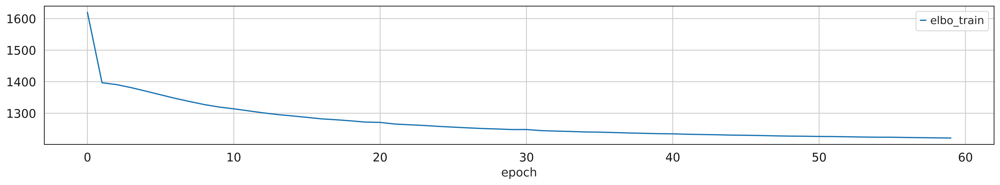

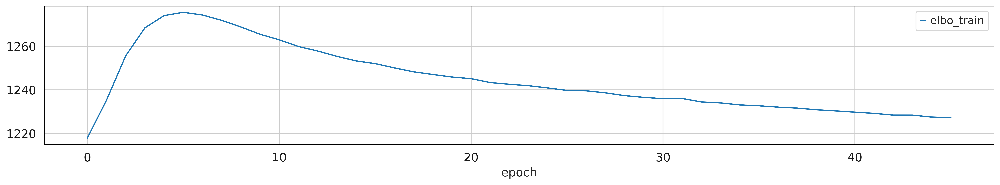

In [24]:
vae.history['elbo_train'].plot(figsize=[20,3])
scanvi.history['elbo_train'].plot(figsize=[20,3])

Query cells: 3265
Query (original) labels:
 qry_celltype
MBP    1488
FBP    1123
HBP     654
Name: count, dtype: int64
INFO     Training for 10 epochs.                                                                                   


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/grathore/conda_envs/gaurav_python_r/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=167` in the `DataLoader` to improve performance.
/home/grathore/conda_envs/gaurav_python_r/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=167` in the `DataLoader` to improve performance.


Training:   0%|          | 0/10 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.



Predicted label fractions (top 50):
                                    n_cells  fraction
pred_celltype                                        
d9_Rostral MHB 3                       1044  0.319755
d9_FB, Presumptive Telencephalon 5      756  0.231547
d9_Hindbrain 0                          606  0.185605
d9_Forebrain 7                          450  0.137825
d9_FB, Presumptive Diencephalon 1       141  0.043185
d9_MHB (Hindbrain side) 8               121  0.037060
d9_Caudal MHB 2                         113  0.034609
d9_Hindbrain 4                           25  0.007657
d9_Neuronal precursors, MB/FB 9           8  0.002450
d9_Neural Crest 10                        1  0.000306

Query vs predicted (row-normalized):
pred_celltype  d9_Caudal MHB 2  d9_FB, Presumptive Diencephalon 1  \
qry_celltype                                                        
FBP                   0.004452                           0.077471   
HBP                   0.012232                           0.003058   
M

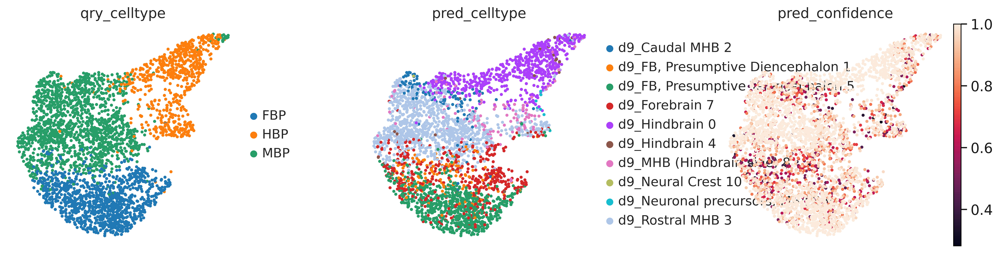

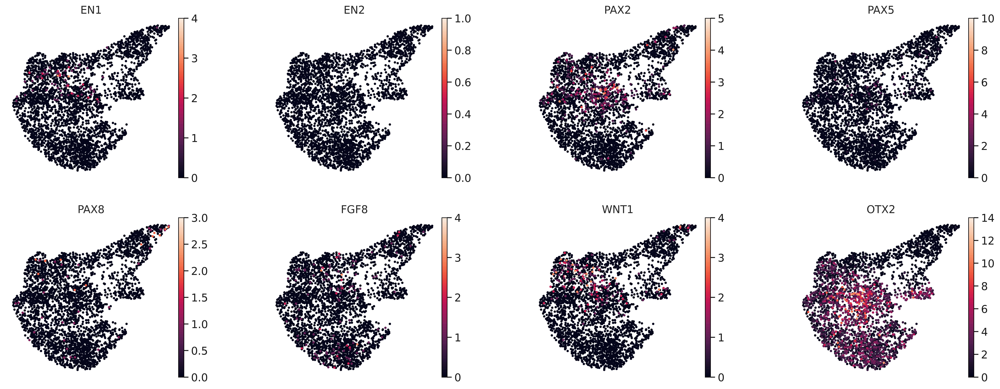

In [ ]:
# =========================
# q-train (query-only adaptation) + predict + confidence + summary + plots
# =========================
import numpy as np
import pandas as pd
import scanpy as sc
import scvi

# ------------------------------------------------------------
# 1) Split query out of the SAME HVG-space container
# ------------------------------------------------------------
qry_mask = adata_hvg.obs["source"] == "qry"
qry_hvg = adata_hvg[qry_mask].copy()

if "qry_celltype" not in qry_hvg.obs.columns:
    raise ValueError("qry_celltype missing. In CELL 1, set: qry.obs['qry_celltype'] = ... before concat.")

print("Query cells:", qry_hvg.n_obs)
print("Query (original) labels:\n", qry_hvg.obs["qry_celltype"].value_counts())

# ------------------------------------------------------------
# 2) Query adaptation (q-train) attached to trained scanvi
# ------------------------------------------------------------
qscanvi = scvi.model.SCANVI.load_query_data(
    qry_hvg,
    scanvi,
    inplace_subset_query_vars=False  # already HVG-aligned
)

qscanvi.train(
    max_epochs=10,
    early_stopping=True,
    batch_size=256,
    train_size=0.9,
    datasplitter_kwargs={"drop_last": True},
)

# ------------------------------------------------------------
# 3) Predict labels + confidence on query
# ------------------------------------------------------------
qry_hvg.obs["pred_celltype"] = pd.Categorical(qscanvi.predict(qry_hvg))

proba = qscanvi.predict(qry_hvg, soft=True)
qry_hvg.obs["pred_confidence"] = proba.max(axis=1)

# Query-adapted latent + UMAP
qry_hvg.obsm["X_qscanvi"] = qscanvi.get_latent_representation()
sc.pp.neighbors(qry_hvg, use_rep="X_qscanvi", n_neighbors=30)
sc.tl.umap(qry_hvg, random_state=0)

# ------------------------------------------------------------
# 4) Summaries: predicted fractions + confusion vs original query label
# ------------------------------------------------------------
ct_counts = qry_hvg.obs["pred_celltype"].value_counts().to_frame("n_cells")
ct_counts["fraction"] = ct_counts["n_cells"] / ct_counts["n_cells"].sum()

print("\nPredicted label fractions (top 50):")
print(ct_counts.head(50))

print("\nQuery vs predicted (row-normalized):")
print(
    pd.crosstab(
        qry_hvg.obs["qry_celltype"].astype(str),
        qry_hvg.obs["pred_celltype"].astype(str),
        normalize="index"
    )
)

# ------------------------------------------------------------
# 5) Plot predicted labels + confidence (+ original query labels)
# ------------------------------------------------------------
sc.pl.umap(qry_hvg, color=["qry_celltype", "pred_celltype", "pred_confidence"], wspace=0.4)

# Optional: sanity-check MHB markers on query (only if present)
mhb_genes = [g for g in ["EN1","EN2","PAX2","PAX5","PAX8","GBX2","FGF8","WNT1","OTX2"] if g in qry_hvg.var_names]
if mhb_genes:
    sc.pl.umap(qry_hvg, color=mhb_genes, wspace=0.4)

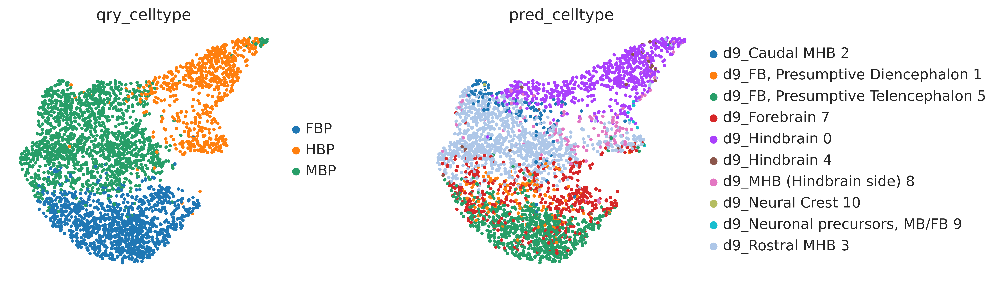

In [27]:
sc.pl.umap(qry_hvg, color=["qry_celltype", "pred_celltype"], wspace=0.4)

# Optional: sanity-check MHB markers on query (only if present)
mhb_genes = [g for g in ["EN1","EN2","PAX2","PAX5","PAX8","GBX2","FGF8","FGF17","WNT1","OTX2"] if g in qry_hvg.var_names]
if mhb_genes:
    sc.pl.umap(qry_hvg, color=mhb_genes, cmap = 'cividis',vmax='p99', wspace=0.4)